# <a id='toc1_'></a>[Predicting AirBnB Review Scores: Exploratory Data Analysis](#toc0_)

Names:
- Artur Rodrigues, arodrigues (at) ucsd (dot) edu 
- Doanh Nguyen, don012 (at) ucsd (dot) edu 
- Ryan Batubara, rbatubara (at) ucsd (dot) edu

## <a id='toc1_1_'></a>[Environment Setup and Package Imports](#toc0_)

All packages used in this project are available on Google Colab. The main packages used are:
- matplotlib
- pandas
- regex
- sklearn
- numpy
- seaborn
- plotly
- collections
- itertools
- ast

The data is taken from [Inside AirBnB](https://insideairbnb.com/get-the-data/), but we have combined them into one csv compressed as a 7z file [here](https://drive.google.com/file/d/1DwNaHBBgTesytLoGn23QZMURfK41Du2K/view?usp=sharing) (requires a UCSD account to access, see why below). The data dictionary for this can be found at [Inside AirBnB data dictionary](https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit?gid=1322284596#gid=1322284596). It is too large to copy here.

### <a id='toc1_1_1_'></a>[Table of Contents](#toc0_)

To summarize, we clean, explore, and visualize our AirBnb dataset in preparation for model creation.

**Table of contents**<a id='toc0_'></a>    
- [Predicting AirBnB Review Scores: Exploratory Data Analysis](#toc1_)    
  - [Environment Setup and Package Imports](#toc1_1_)    
  - [Introduction](#toc1_2_)    
    - [Abstract](#toc1_2_1_)    
    - [Dataset](#toc1_2_2_)    
    - [Document Structure](#toc1_2_3_)    
  - [Data Preprocessing](#toc1_3_)    
    - [Data Cleaning](#toc1_3_1_)    
    - [Dropping Unecessary Columns](#toc1_3_2_)    
    - [Dropping 0 Review Listings](#toc1_3_3_)    
    - [Fixing Datatypes](#toc1_3_4_)    
  - [General Data EDA](#toc1_4_)    
    - [General Data Visualizations](#toc1_4_1_)    
    - [Review Scores Distribtion](#toc1_4_2_)    
  - [Numerical Data EDA](#toc1_5_)    
    - [Pairplot](#toc1_5_1_)    
    - [Correlation Heatmap](#toc1_5_2_)    
    - [Price Deep Dive](#toc1_5_3_)    
    - [Missingness Analysis](#toc1_5_4_)    
    - [Host Age](#toc1_5_5_)    
  - [Text and Categorical EDA](#toc1_6_)    
    - [Categorical Data Overview](#toc1_6_1_)    
    - [Text Word Counting](#toc1_6_2_)    
    - [Categorical Distributions](#toc1_6_3_)    
  - [Conclusions](#toc1_7_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

## <a id='toc1_2_'></a>[Introduction](#toc0_)

### <a id='toc1_2_1_'></a>[Abstract](#toc0_)

With the end of the Covid 19 pandemic, there has been a huge boom in travel and entertainment industries worldwide. With the pandemic still in the minds of many people, travelers may tend to seek more private and personal accommodations such as those on AirBnB. Here, we predict the review score (on a scale of 0 to 100) of an AirBnB posting based on various features, like amenities available, number of reviews, price, and others. The intention is that this may provide AirBnB hosts better insight into what makes a highly rated AirBnB experience. In this notebook in particular, we explore the dataset to better understand how we can make our model.

### <a id='toc1_2_2_'></a>[Dataset](#toc0_)

This project will be based on data gathered by [Inside AirBnb](https://insideairbnb.com/get-the-data/) May to June 2024. To keep our analysis more focused, we will only be analyzing AirBnB listings from the United States. Since Inside AirBnB only offers datasets per city, we have downloaded all US cities with AirBnB listings and combined them into one csv file. Due to the size of this file, [Inside AirBnB reposting policies](https://insideairbnb.com/data-policies/), and [Github Data storage policies](https://docs.github.com/en/repositories/working-with-files/managing-large-files/about-storage-and-bandwidth-usage), we will not be uploading this combined file to the repository. That said, the combined dataset is available [here](https://drive.google.com/file/d/1DwNaHBBgTesytLoGn23QZMURfK41Du2K/view?usp=sharing), but requires a UCSD account.

A data dictionary for the data can be found at [Inside AirBnB's data dictionary](https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit?gid=1322284596#gid=1322284596).

### <a id='toc1_2_3_'></a>[Document Structure](#toc0_)

This exploratory data analysis will be split into four parts:

- [Data Preprocessing](#data-preprocessing), where we import and process the data.
- [General Data EDA](#general-data-eda), where we visualize general information about the dataset.
- [Numerical Data EDA](#numerical-data-eda), where we see how numerical features relate to predicting review scores.
- [Text and Categorical Data EDA](#text-and-categorical-eda), where we see how textual and categorical data may help our predictions.

Let's get started.

## <a id='toc1_3_'></a>[Data Preprocessing](#toc0_)

In [1]:
# Main data libraries
import pandas as pd
import numpy as np

# Plotting and dislpay imports
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from IPython.display import display, Markdown

# Data processing imports
import regex as re
import ast
from itertools import chain
from collections import Counter

In [2]:
df_large = pd.read_csv("combined_output.csv", low_memory=False)
Markdown(df_large.head(1).to_markdown()) # Display as Markdown to force all columns to appear

|    |      id | listing_url                          |      scrape_id | last_scraped   | source      | name                       | description                                                                                                                                                            |   neighborhood_overview | picture_url                                                     |   host_id | host_url                                  | host_name   | host_since   | host_location   | host_about                               | host_response_time   | host_response_rate   | host_acceptance_rate   | host_is_superhost   | host_thumbnail_url                                                                                    | host_picture_url                                                                                         |   host_neighbourhood |   host_listings_count |   host_total_listings_count | host_verifications   | host_has_profile_pic   | host_identity_verified   |   neighbourhood | neighbourhood_cleansed   |   neighbourhood_group_cleansed |   latitude |   longitude | property_type      | room_type       |   accommodates |   bathrooms | bathrooms_text   |   bedrooms |   beds | amenities                                                                                                                          | price   |   minimum_nights |   maximum_nights |   minimum_minimum_nights |   maximum_minimum_nights |   minimum_maximum_nights |   maximum_maximum_nights |   minimum_nights_avg_ntm |   maximum_nights_avg_ntm |   calendar_updated | has_availability   |   availability_30 |   availability_60 |   availability_90 |   availability_365 | calendar_last_scraped   |   number_of_reviews |   number_of_reviews_ltm |   number_of_reviews_l30d | first_review   | last_review   |   review_scores_rating |   review_scores_accuracy |   review_scores_cleanliness |   review_scores_checkin |   review_scores_communication |   review_scores_location |   review_scores_value |   license | instant_bookable   |   calculated_host_listings_count |   calculated_host_listings_count_entire_homes |   calculated_host_listings_count_private_rooms |   calculated_host_listings_count_shared_rooms |   reviews_per_month |
|---:|--------:|:-------------------------------------|---------------:|:---------------|:------------|:---------------------------|:-----------------------------------------------------------------------------------------------------------------------------------------------------------------------|------------------------:|:----------------------------------------------------------------|----------:|:------------------------------------------|:------------|:-------------|:----------------|:-----------------------------------------|:---------------------|:---------------------|:-----------------------|:--------------------|:------------------------------------------------------------------------------------------------------|:---------------------------------------------------------------------------------------------------------|---------------------:|----------------------:|----------------------------:|:---------------------|:-----------------------|:-------------------------|----------------:|:-------------------------|-------------------------------:|-----------:|------------:|:-------------------|:----------------|---------------:|------------:|:-----------------|-----------:|-------:|:-----------------------------------------------------------------------------------------------------------------------------------|:--------|-----------------:|-----------------:|-------------------------:|-------------------------:|-------------------------:|-------------------------:|-------------------------:|-------------------------:|-------------------:|:-------------------|------------------:|------------------:|------------------:|-------------------:|:------------------------|--------------------:|------------------------:|-------------------------:|:---------------|:--------------|-----------------------:|-------------------------:|----------------------------:|------------------------:|------------------------------:|-------------------------:|----------------------:|----------:|:-------------------|---------------------------------:|----------------------------------------------:|-----------------------------------------------:|----------------------------------------------:|--------------------:|
|  0 | 2992450 | https://www.airbnb.com/rooms/2992450 | 20240607164239 | 2024-06-07     | city scrape | Luxury 2 bedroom apartment | The apartment is located in a quiet neighborhood . Fully furnished. Linens and towels are provided. It's two blocks away from downtown Albany, and the Palace theater. |                     nan | https://a0.muscache.com/pictures/44627226/0e72c75c_original.jpg |   4621559 | https://www.airbnb.com/users/show/4621559 | Kenneth     | 2013-01-07   | New York, NY    | I am a real down to earth & cool person. | within a few hours   | 100%                 | 100%                   | f                   | https://a0.muscache.com/im/users/4621559/profile_pic/1363081467/original.jpg?aki_policy=profile_small | https://a0.muscache.com/im/users/4621559/profile_pic/1363081467/original.jpg?aki_policy=profile_x_medium |                  nan |                     1 |                           5 | ['email', 'phone']   | t                      | f                        |             nan | THIRD WARD               |                            nan |    42.6579 |    -73.7537 | Entire rental unit | Entire home/apt |              4 |           1 | 1 bath           |          2 |      2 | ["Essentials", "Air conditioning", "Wifi", "Kitchen", "TV with standard cable", "Smoke alarm", "Carbon monoxide alarm", "Heating"] | $70.00  |               28 |             1125 |                       28 |                       28 |                     1125 |                     1125 |                       28 |                     1125 |                nan | t                  |                 0 |                 0 |                 0 |                 68 | 2024-06-07              |                   9 |                       0 |                        0 | 2014-07-01     | 2022-08-17    |                   3.56 |                     3.44 |                        3.56 |                    4.22 |                          4.56 |                     3.22 |                  3.67 |       nan | f                  |                                1 |                                             1 |                                              0 |                                             0 |                0.07 |

### <a id='toc1_3_1_'></a>[Data Cleaning](#toc0_)

### <a id='toc1_3_2_'></a>[Dropping Unecessary Columns](#toc0_)

Some columns in the original data are unecessary for our purposes. For a detailed description of each column, see the [Inside AirBnB Data Dictionary](https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit?gid=1322284596#gid=1322284596).

We list reasons for dropping these columns:
- `All URL`: Unique elements for each listing. Does not contribute anything when predicting the review score.

- `All ID`: Unique elements for each listing. Does not contribute anything when predicting the review score.

- `host_name`: Indiviudally unique elements for each listing. Does not contribute anything when predicting the review score.

- `license`: Unique elements for each listing. Does not contribute anything when predicting the review score.

- `source`: Holds whether or not the listing was found via searching by city or if the listing was seen in a previous scrape. There is no logical
connection between this and the target variable, which is review score.

- `host_location`: Private information.

- `host_total_listings_count`: There exists another feature called `host_listings_count`, this is a duplicate feature.

- `calendar_last_scarped`: Holds the date of the last time the data was scrapped, no logical connection between this and predicting `review_score_rating`.

- `first & last review`: provides temporal data for the first & last review date. Last review date can be misleading as an unpopular listing may have no reviews for an extended amount of time, and suddenly get a review.

- `minimum_minimum_nights, maximum_minimum_nights, minimum_maximum_nights, maximum_maximum_nights`: The all time minimum and maximum of a listing's minimum and maximum nights requirement for booking. This has no correlation to review score because you cannot write a review if you have not stayed at the listing. A person who wants to book a listing for 10 days is not going to book a listing that has a maximum night stay of 9 days.

In [3]:
df_dropped = df_large.drop(columns=[
    'listing_url', 
    'scrape_id', 
    'picture_url', 
    'host_id', 
    'host_url', 
    'host_name', 
    'host_thumbnail_url',
    'host_picture_url', 
    'minimum_minimum_nights',
    'maximum_minimum_nights', 
    'minimum_maximum_nights',
    'maximum_maximum_nights', 
    'calendar_updated',
    'license',
    'calendar_last_scraped',
    'id',
    'source',
    'host_location',
    'host_total_listings_count',
    'first_review',
    'last_review'
])

In [4]:
df_large.shape, df_dropped.shape

((276371, 75), (276371, 54))

### <a id='toc1_3_3_'></a>[Dropping 0 Review Listings](#toc0_)

Since we are trying to predict AirBnB review scores (for the purpose of finding out what makes a good review score), we will be dropping all listings that have 0 reviews. This is because, from the perspective of our model, these rows do not provide any meaningful information into what makes a highly rated listing (since their review scores are `NaN`, and are missing by design).

We remark that this still leaves us with almost 200 thousand rows, so the data remains large enough for a model.

In [5]:
df_nonzero = df_dropped[df_dropped['number_of_reviews'] > 0]
df_dropped.shape, df_nonzero.shape

((276371, 54), (217171, 54))

### <a id='toc1_3_4_'></a>[Fixing Datatypes](#toc0_)

Some columns have incorrect datatypes, such as:
- `host_response_rate` and `host_acceptance_rate` should be change from a `str` percent to a `float`.
- `host_is_superhost`, `host_has_profile_pic`, `host_identity_verified`, `has_availability`, `instant_bookable` should be booleans.
- `last_scraped` and `host_since` should be Pandas timestamps.
- `price` should be a float in dollars.
- `amenities` should be a list.

In [7]:
df = df_nonzero.copy()

df['host_response_rate'] = df['host_response_rate'].str.strip("%").astype('float') / 100
df['host_acceptance_rate'] = df['host_acceptance_rate'].str.strip("%").astype('float') / 100

bool_dict = {'t':True, 'f':False}
df['host_is_superhost'] = df['host_is_superhost'].replace(bool_dict)
df['host_has_profile_pic'] = df['host_has_profile_pic'].replace(bool_dict)
df['host_identity_verified'] = df['host_identity_verified'].replace(bool_dict)
df['has_availability'] = df['has_availability'].replace(bool_dict)
df['instant_bookable'] = df['instant_bookable'].replace(bool_dict)

df['last_scraped'] = pd.to_datetime(df['last_scraped'], format="%Y-%m-%d")
df['host_since'] = pd.to_datetime(df['host_since'], format="%Y-%m-%d")

df['price'] = df['price'].str.strip("$").str.replace(',','').astype('float')

df['amenities'] = df['amenities'].apply(lambda x: ast.literal_eval(x))

Markdown(df.head(1).to_markdown())

C:\Users\ryany\AppData\Local\Temp\ipykernel_15912\974637563.py:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['instant_bookable'] = df['instant_bookable'].replace(bool_dict)


|    | last_scraped        | name                       | description                                                                                                                                                            |   neighborhood_overview | host_since          | host_about                               | host_response_time   |   host_response_rate |   host_acceptance_rate | host_is_superhost   |   host_neighbourhood |   host_listings_count | host_verifications   | host_has_profile_pic   | host_identity_verified   |   neighbourhood | neighbourhood_cleansed   |   neighbourhood_group_cleansed |   latitude |   longitude | property_type      | room_type       |   accommodates |   bathrooms | bathrooms_text   |   bedrooms |   beds | amenities                                                                                                                          |   price |   minimum_nights |   maximum_nights |   minimum_nights_avg_ntm |   maximum_nights_avg_ntm | has_availability   |   availability_30 |   availability_60 |   availability_90 |   availability_365 |   number_of_reviews |   number_of_reviews_ltm |   number_of_reviews_l30d |   review_scores_rating |   review_scores_accuracy |   review_scores_cleanliness |   review_scores_checkin |   review_scores_communication |   review_scores_location |   review_scores_value | instant_bookable   |   calculated_host_listings_count |   calculated_host_listings_count_entire_homes |   calculated_host_listings_count_private_rooms |   calculated_host_listings_count_shared_rooms |   reviews_per_month |
|---:|:--------------------|:---------------------------|:-----------------------------------------------------------------------------------------------------------------------------------------------------------------------|------------------------:|:--------------------|:-----------------------------------------|:---------------------|---------------------:|-----------------------:|:--------------------|---------------------:|----------------------:|:---------------------|:-----------------------|:-------------------------|----------------:|:-------------------------|-------------------------------:|-----------:|------------:|:-------------------|:----------------|---------------:|------------:|:-----------------|-----------:|-------:|:-----------------------------------------------------------------------------------------------------------------------------------|--------:|-----------------:|-----------------:|-------------------------:|-------------------------:|:-------------------|------------------:|------------------:|------------------:|-------------------:|--------------------:|------------------------:|-------------------------:|-----------------------:|-------------------------:|----------------------------:|------------------------:|------------------------------:|-------------------------:|----------------------:|:-------------------|---------------------------------:|----------------------------------------------:|-----------------------------------------------:|----------------------------------------------:|--------------------:|
|  0 | 2024-06-07 00:00:00 | Luxury 2 bedroom apartment | The apartment is located in a quiet neighborhood . Fully furnished. Linens and towels are provided. It's two blocks away from downtown Albany, and the Palace theater. |                     nan | 2013-01-07 00:00:00 | I am a real down to earth & cool person. | within a few hours   |                    1 |                      1 | False               |                  nan |                     1 | ['email', 'phone']   | True                   | False                    |             nan | THIRD WARD               |                            nan |    42.6579 |    -73.7537 | Entire rental unit | Entire home/apt |              4 |           1 | 1 bath           |          2 |      2 | ['Essentials', 'Air conditioning', 'Wifi', 'Kitchen', 'TV with standard cable', 'Smoke alarm', 'Carbon monoxide alarm', 'Heating'] |      70 |               28 |             1125 |                       28 |                     1125 | True               |                 0 |                 0 |                 0 |                 68 |                   9 |                       0 |                        0 |                   3.56 |                     3.44 |                        3.56 |                    4.22 |                          4.56 |                     3.22 |                  3.67 | False              |                                1 |                                             1 |                                              0 |                                             0 |                0.07 |

The dataset does look much neater now.

## <a id='toc1_4_'></a>[General Data EDA](#toc0_)

### <a id='toc1_4_1_'></a>[General Data Visualizations](#toc0_)

Let's start by plotting all the AirBnB listing in our dataset on a map.

In [6]:
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", zoom=3, height=600)

fig.update_layout(
    mapbox_style="open-street-map",
    margin={"r":0, "t":0, "l":0, "b":0}
)

fig.show()

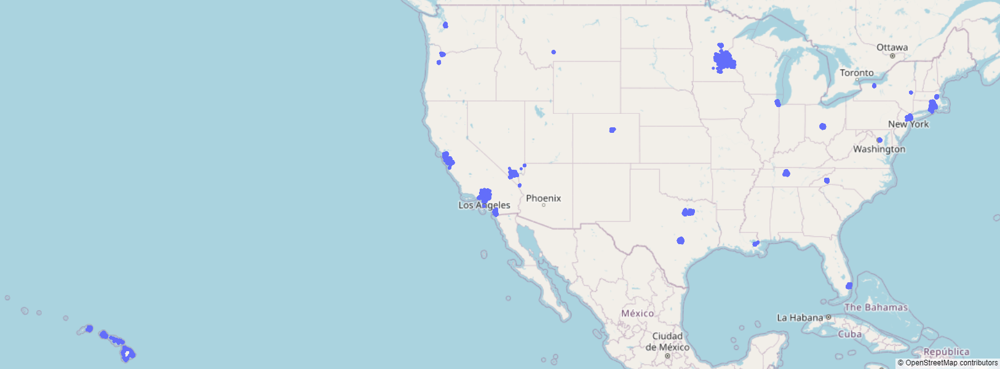

In [7]:
from IPython.display import Image
Image("../figures/Map.png")

Right away we notice that the dots, which represent individual listings, are not evenly distributed across the United States. There are about two-dozen areas of concentration on the map where listings are abundant and densely packed, and apart from these areas, there are not really any dots elsewhere. This plotting of our data shows something interesting which are the main points of concentration in the United States both from a population density standpoint, but also from a tourism standpoint. We can expect there to be some decent correlation between latitude and longitude when we look at our heatmap later since all of our data is from the USA, but especially because of the two-dozen or so areas of concetration.

### <a id='toc1_4_2_'></a>[Review Scores Distribtion](#toc0_)

Since review scores are the target output for our model, let's try and understand what its distribution looks like. Note that there are multiple review metrics:
- `review_scores_rating`: The average overall review score, out of 5.
- `review_scores_accuracy`: The average listing accuracy score, out of 5.
- `review_scores_cleanliness`: The average cleanliness score, out of 5.
- `review_scores_checkin`: The average checkin score, out of 5.
- `review_scores_communication`: The average communication score, out of 5.
- `review_scores_location`: The average location score, out of 5.
- `review_scores_value`: The average value score, out of 5.

First let's ask Pandas to give us a description.

In [15]:
review_cols = list(filter(lambda x: "review_scores" in x, df.columns))

df[review_cols].describe()

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,217171.000000,216912.000000,216925.000000,216893.000000,216919.000000,216888.000000,216889.000000
mean,4.783007,4.810052,4.763962,4.861785,4.860681,4.796901,4.705843
std,0.372480,0.361587,0.388870,0.321136,0.333386,0.336128,0.405304
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.730000,4.780000,4.700000,4.860000,4.860000,4.750000,4.640000
50%,4.890000,4.920000,4.880000,4.960000,4.960000,4.900000,4.800000
75%,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,4.930000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


Since the mean values are quite high, let's plot an overlaid histogram for scores 4.5 to 5.

In [116]:
# Make histogram for each review column
fig = go.Figure()
for col in review_cols:
    fig.add_trace(go.Histogram(
        x = df[col],
        name = col,
        opacity = 0.5,
        nbinsx=200
    ))

# Add information to plot
fig.update_layout(
    barmode='overlay',
    title = 'Histogram of All US AirBnB Review Types',
    xaxis = dict(range=[4.5, 5]),
    xaxis_title = 'Score (out of 5)',
    yaxis_title = 'Count'
)

fig.show()

It appears that a very large number of listings have very high review scores. Furthermore, the distribution of all the review score columns are almost identical. Therefore, **moving onwards we will say review scores refers to the `review_scores_rating` column, and this is the column our model will aim to predict**. This is because the review score columns are all very similar, and review_scores_rating, being the average of all these values, is by far the most representative.

Now that we have a general sense of the overal layout of the data, we start to dive deeper into the numerical columns in our dataset.

## <a id='toc1_5_'></a>[Numerical Data EDA](#toc0_)

### <a id='toc1_5_1_'></a>[Pairplot](#toc0_)
Let's start by drawing a pairplot of all the features we have in our dataset. Due to the size of out dataset, we will only draw the pairplot for 1000 sampled points. We believe this already shows enough information. A high resolution image of the plot is available at `pairplot.png`.

In [27]:
# This takes a very long time to plot (30 min)
# so we display the resulting image instead
# for zoomable high resolution see 'pairplot.png' in the current dir
# sns.pairplot(df.sample(1000))

from IPython.display import display, Image
Image("pairplot.png")

There are many trivial relationships that can be seen in the pairplot, e.g. higher number of listings tends to mean higher number of ratings, or number of beds tends to increase with number of bedrooms, so rather than talking about all of the relationships that we are seeing, we shall talk about the non-trivial ones. Also, near the middle of the pairplots we can see a 4x4 square of the `availability_365`, `availability_90`, `availability_60`, and `availability_30` features, these plots look very linear which would make sense given that they are all intimately related as subsets and supersets of one another.

If we look at the pairplot for `number_of_review_ltm` x `beds` we see that the more reviews that a listing has in the last twelve months, the less beds the listing tends to have. This could be due to properties in popular areas generally being of a smaller size as housing costs near dense regions tends to be higher, it could also be that AirBnB users are generally renting places in smaller groups, which would make sense as lots of couples and families look for places where they can have a fun weekend getaway.

We can also see on the pairplot for `calculated_host_listings_count` x `accomodates` that the more listings a host has, the less people each of their listings tends to accomodate. A potential reason for this could be that it is a more common business strategy for a host to have multiple smaller (thus cheaper) properties listed, rather than one or two larger (thus more expensive) properties listed as this allows for more customers to flow in and out of their properties. Another potential reason, which kind of ties into the above observation, may be that properties in popular areas tend to be smaller in size due to housing/population density so hosts would rather buy smaller but popular properties rather than larger and less popular properties.

Interestingly, if we look at the pairplot for `host_listings_count` x `number_of_reviews` we notice that as the number listings a host has increases, the number of reviews very quickly decreases. This could be an indication that hosts with fewer listings are more concerned about their reputation, which may lead them to incentivise users to leave reviews after their stay and tend to customer satisfation, whereas hosts with more listings don't have the capability to do that due to the large number of listings they would have to tend to.

### <a id='toc1_5_2_'></a>[Correlation Heatmap](#toc0_)

Now let's see how the numerical columns correlate with each other through a heatmap. Note that a high quality image of the heatmap is in the directory as `corr.png`.

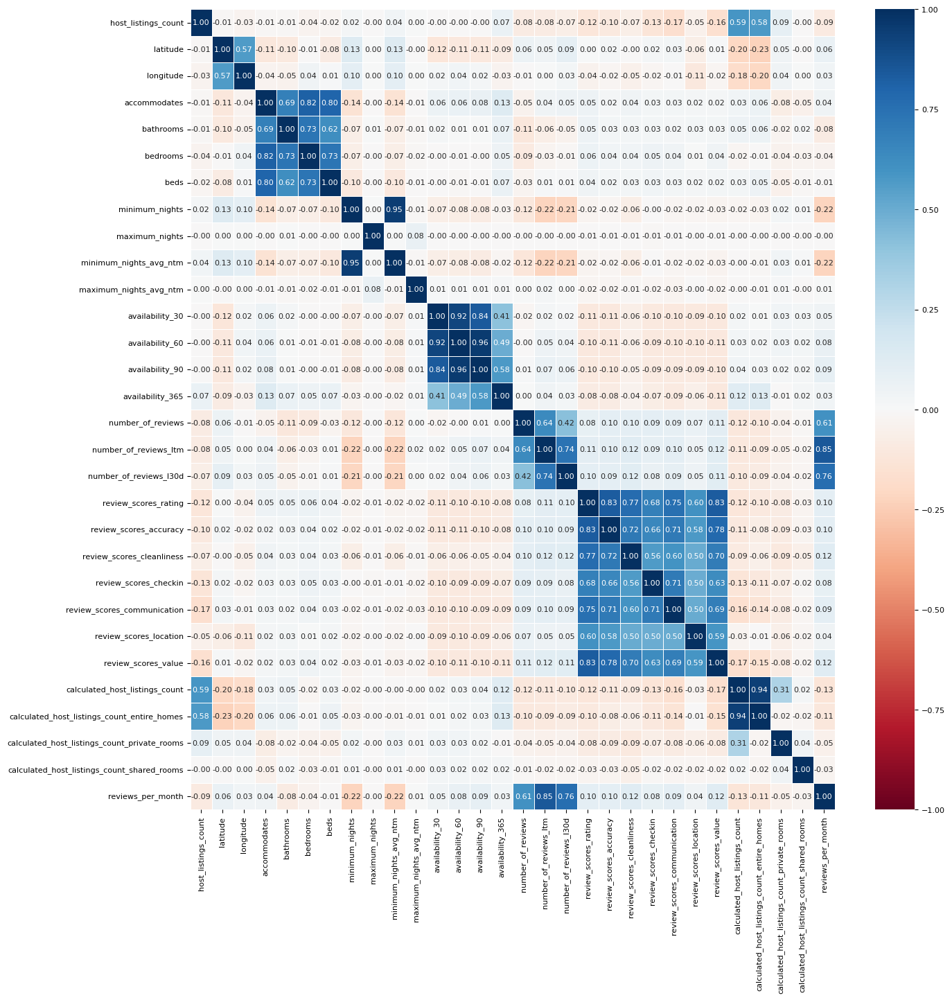

In [ ]:
plt.figure(figsize=(15,15))
with plt.rc_context({'font.size':8}):
    sns.heatmap(
        df.select_dtypes(np.number).corr(),
        linewidths=0.5,
        annot=True,
        fmt=".2f",
        vmin=-1,vmax=1,
        center=0,
        cmap='RdBu'
    )

Right away, the thing that stands out the most is that large blue square region in the bottom right quadrant of the heatmap above. These features all have high correlations with one another because they are all review scores. `review_scores_rating` is our target, what our model is trying to predict, and the other features, namely `review_scores_accuracy`, `review_scores_cleanliness`, `review_scores_checkin`, `review_scores_communication`, `review_scores_location`, `review_scores_value`, are all more specific categories of the overall review scores. We are going to be dropping all of these columns review score columns when preprocessing our dataset in preparation for our model training as they would be giving our model hints at what the overall `review_scores_rating` should be. This would be like trying to guess what square footage home a family is going to purchase given their annual family income, while there isn't a perfect correlation, a family's annual income is a pretty good indication of the size home they are going to be able to afford (assuming a specific area/location).

Closer to the middle of the heatmap, we see a 3x3 and a 4x4 square of high correlation features. The 3x3 square shows the correlation between the `number_of_reviews`, `number_of_reviews_ltm` (ltm stands for Last Twelve Months), and `number_of_reviews_l30d` (l30d stands for Last 30 Days) features. It makes sense why these would be highly correlated as `number_of_reviews` is a super set of `number_of_reviews_ltm` which is a superset of `number_of_reviews_l30d`. The 4x4 square shows the correlation between the `availability_365`, `availability_90`, `availability_60`, `availability_30` (`availability_X` means the listing's availability in the last X days) features. Similarly to the 3x3 square, it makes sense why the features in the 4x4 square would be highly correlated since `availability_365` is a superset of `availability_90` which is a superset of `availability_60` which is a superset of `availability_30`.

Now, in the top left quadrant of the heatmap, we see two 2x2 squares and one 4x4 square of high correlation features. The relatively highly correlated 2x2 square which contains the `latitude` and `longitude` features makes sense since we are looking at only listings in the United States and there are areas in the US that are highly population dense relative to the other areas. The other 2x2 square of highly correlated data contains the `host_listings_count` and `host_total_listings_count` features which would make sense since in the data dictionary both of these features contain the exact same description and we believe that this is some sort of duplicate column. The 4x4 square of high correlated contains the `accomodates`, `bathrooms`, `bedrooms`, `beds` features which should be highly corelated since the numbers of bedrooms, bathrooms, beds, and numbed of people the listing can accomodate are all proportional and related to the size of the listing.

Near the middle of the last row of the heatmap, in a 1x3 rectangle, we can see a high correlation between the `reviews_per_month` feature and the `number_of_reviews`, `number_of_reviews_ltm`, `number_of_reviews_l30d` features, which would make sense considering that they are all encoding the number of reviews that a listing has.

### <a id='toc1_5_3_'></a>[Price Deep Dive](#toc0_)

The price column is particularly sensitive and important so lets try to understand its distribution a bit better.

In [123]:
df['price'].describe()

count    185740.000000
mean        265.073646
std        1554.970264
min           6.000000
25%         100.000000
50%         160.000000
75%         266.000000
max      100000.000000
Name: price, dtype: float64

<Axes: title={'center': 'Price Distribution (Large Outliers Removed)'}, ylabel='Frequency'>

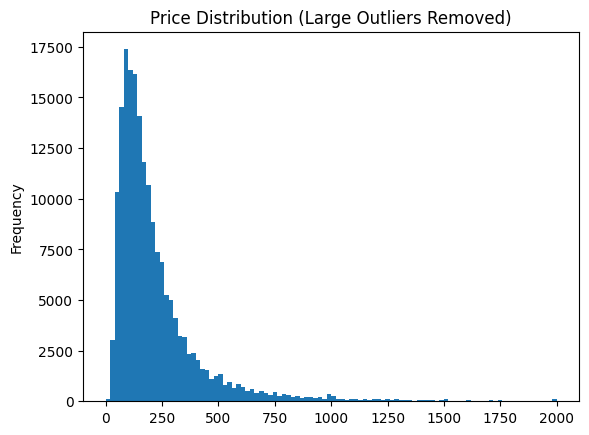

In [148]:
df['price'].plot(
    kind='hist', 
    bins=100, 
    title='Price Distribution (Large Outliers Removed)',
    range=[0,2000]
)

Here is the histogram of the price distribution per night. Averages is 265 dollars per night (due to outliers), with the occasional really expensive listings. The median is 160 dollars, which makes much more sense.

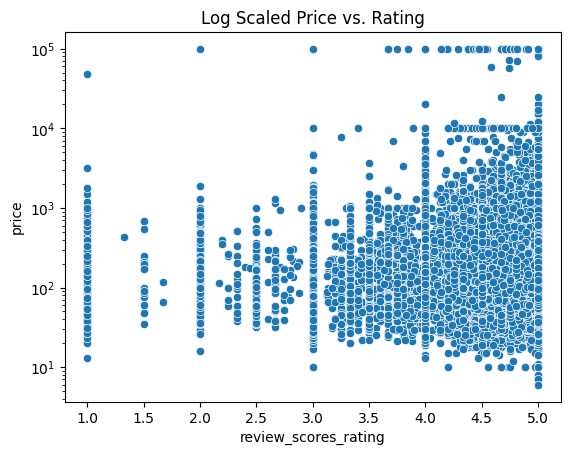

In [166]:
sns.scatterplot(
    df,
    y='price',
    x='review_scores_rating'
)

plt.yscale('log')
plt.title("Log Scaled Price vs. Rating");

It appears that price increases as the ratings go up, with many exceptions. There does not seem to be any general trend though, except that there are vertical lines where the ratings are integer values - this is probably from all the listings with very small reviews. Even in these lines there is not general relationship it appears.

### <a id='toc1_5_4_'></a>[Missingness Analysis](#toc0_)

We end this section by analyzing the missingness of our data. We begin by plotting the number of missing values in each column.

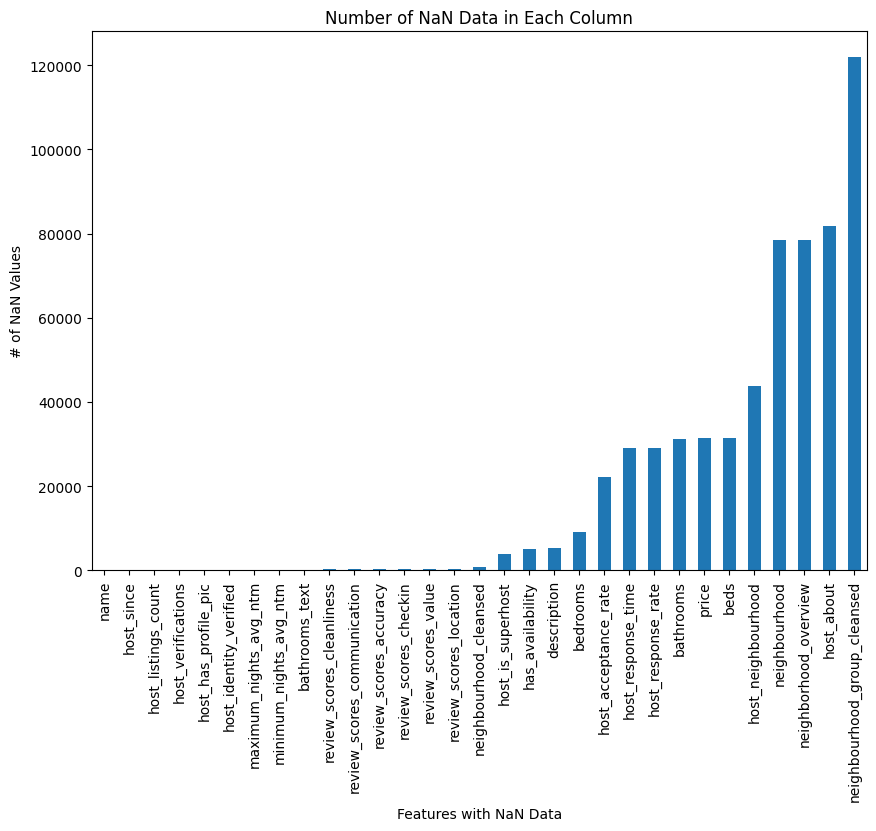

In [159]:
# Count missing per column
nan_counter = df.isnull().sum()
nan_counter = nan_counter[nan_counter > 0].sort_values()

# Plot NaN data
plt.figure(figsize=(10, 7))
nan_counter.plot(kind='bar')
plt.title('Number of NaN Data in Each Column')
plt.xlabel('Features with NaN Data')
plt.ylabel('# of NaN Values')
plt.show()

It appears that most columns have very few msising values, if any. Many host response and acceptance rates are missing, perhaps due to privacy settings. Furthermore, many price and bed values are missing, which is strange but sensible considering they are user inputted values on AirBnB (e.g. price can be on contact). The neighborhood columns are largely missing, because they appear to only be non-null for metropolitan areas, and many listings are not in such urban and well documented locations.

### <a id='toc1_5_5_'></a>[Host Age](#toc0_)

One last numerical piece of information we can analyze is when hosts joined AirBnB. Here we plot it the year joined.

<Axes: title={'center': 'Host Joined by Year'}, xlabel='host_since'>

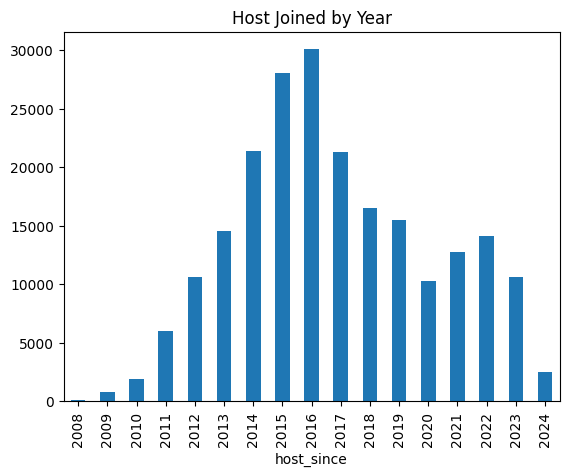

In [169]:
(df['host_since']
    .dt.to_period('Y')
    .value_counts()
    .sort_index()
    .plot(
        kind='bar',
        title='Host Joined by Year'
    )
)

From 2008 to 2017, the company experience the exponential growth most companies grow through as the numbers of host joined grows exponentially during this time period. After that, it faces a slow decrease, while plummeting in 2020 due to most people staying inside because of the quarantine, making airbnb less profitable. After quarantine ended, it is met with a nice and steady increased in hosts joined as families flock out of their quarantine to be anywhere else besides in their own home. 

Now that we have a better grasp of the numerical columns in our dataset, we shift our focus to the non-numerical columns.

## <a id='toc1_6_'></a>[Text and Categorical EDA](#toc0_)

### <a id='toc1_6_1_'></a>[Categorical Data Overview](#toc0_)

We start by looking at some of the categorical columns in our dataset. Let's start by printing all the non-numerical columns we have:

In [119]:
text_cat_cols = list(filter(lambda x: x not in df.select_dtypes(np.number).columns, df.columns))
text_cat_cols

['last_scraped',
 'name',
 'description',
 'neighborhood_overview',
 'host_since',
 'host_about',
 'host_response_time',
 'host_is_superhost',
 'host_neighbourhood',
 'host_verifications',
 'host_has_profile_pic',
 'host_identity_verified',
 'neighbourhood',
 'neighbourhood_cleansed',
 'neighbourhood_group_cleansed',
 'property_type',
 'room_type',
 'bathrooms_text',
 'amenities',
 'has_availability',
 'instant_bookable']

### <a id='toc1_6_2_'></a>[Text Word Counting](#toc0_)

First let's explore the descriptive features `name`, `description`, `neighborhood_overview`, and `bathrooms_text` - text data the hosts have control over. To keep things short and clear, we will only show a deep analysis for `name`, since this is the first thing a person sees about a listing on AirBnB. 

One guiding EDA question we can use then is how often various words appear in the name of a listing. More spepcifically, are there certain words that are more commmon among highly popular listings that are not as prevalent in the general population? Let's define a popular listing as any listing with an overall rating of `4.9` or higher and at least `100` reviews. There are still around 15 thousand of these listings, but it should help give a sense of whether these listings are named differently than the rest of the population.

It appears that the most common non-filler words in the good and all listing's name is `private`. But `house`, `suite`, and `downtown` are far more common for the good listings, and `pool`, `bedroom`, and `room` are more common in all listings than in the good ones - this may be the basis of some encoding or Binarizer for our model later on. We summarize these results in the following bar chart:

In [9]:
df_good = df[(df['review_scores_rating'] >= 4.9) & (df['number_of_reviews'] >= 100)]
df_good.shape # Number of really good listings based on our definition

(16161, 54)

In [10]:
def count_words(df_here, col):
    """ Counts ths number of words in the given col and DataFrame """
    # Count most common words as proportions in the good listings
    text = ' '.join(df_here[col].convert_dtypes(str).dropna())
    words = re.findall(r'\b\w+\b', text.lower())
    name_count = Counter(words)

    # Convert to dataframe
    name_df = (pd.DataFrame.from_dict(
        name_count, 
        orient='index', 
        columns=['count']
    )   
        .reset_index()
        .rename(columns={'index': 'word'})
        .sort_values(by='count', ascending=False)
    )

    # Normalize as proportion and add rank
    name_df['count_prop'] = name_df['count'] / name_df['count'].sum()
    name_df['rank'] = name_df['count_prop'].rank(ascending=False)

    return name_df

good_name_df = count_words(df_good, 'name')
all_name_df = count_words(df, 'name')

# Merge the dataframes
name_df = (pd.merge(
    good_name_df, all_name_df, 
    on='word',
    how='outer', 
    suffixes=('_good','_all')
)
    .sort_values(by='count_good', ascending=False)
)

name_df.head(30)

,word,count_good,count_prop_good,rank_good,count_all,count_prop_all,rank_all
16338,in,2973.0,0.027643,1.0,37581,0.026288,1.0
23488,private,2496.0,0.023208,2.0,23470,0.016417,2.0
28152,to,2064.0,0.019191,3.0,23467,0.016415,3.0
27935,the,1975.0,0.018364,4.0,21632,0.015132,4.0
15708,home,1474.0,0.013706,5.0,20676,0.014463,6.0
15909,house,1350.0,0.012553,6.0,12499,0.008743,17.0
30256,with,1302.0,0.012106,7.0,16775,0.011734,11.0
7357,beach,1210.0,0.011251,8.0,17934,0.012545,9.0
27143,studio,1199.0,0.011149,9.0,15646,0.010944,12.0
27286,suite,1197.0,0.011130,10.0,10091,0.007059,23.0


It appears that the most common non-filler words in the good and all listings name is `private`. But `house`, `suite`, and `downtown` are far more common for the good listings, and `pool`, `bedroom`, and `room` are more common in all listings than in good ones - this may be the basis of some encoding or Binarizer for our model later on. We summarize these results in the following bar chart:



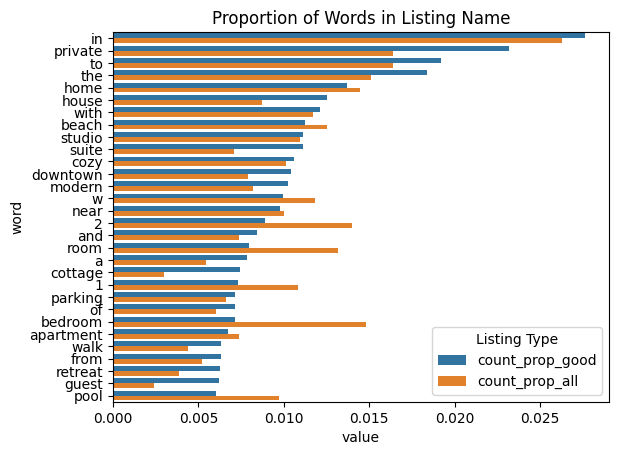

In [13]:
name_melted_df = name_df.head(30).melt(
    id_vars='word',
    value_vars=['count_prop_good','count_prop_all'],
    var_name='Listing Type',
    value_name='value'
)

ax = sns.barplot(
    name_melted_df,
    x='value',
    y='word',
    hue='Listing Type',
)

ax.set_title('Proportion of Words in Listing Name')

plt.show()

The barplot does indeed match the numbers and analysis we had above.

### <a id='toc1_6_3_'></a>[Categorical Distributions](#toc0_)

The data has plenty of categorical columns, but a few stand out as being more interesting, in particular the `amenities`, `property_type`, `room_type`, and `host_verifications`.

In [115]:
pd.Series(Counter(chain.from_iterable(df['amenities'])))

Essentials                                                           195481
Air conditioning                                                     111136
Wifi                                                                 194103
Kitchen                                                              193943
TV with standard cable                                                28891
                                                                      ...  
Bed bath and Beyond shampoo                                               1
Bed bath and beyond body soap                                             1
Bed bath and beyond conditioner                                           1
Bose SL3 Bluetooth Speaker sound system with Bluetooth and aux            1
Housekeeping available Monday, Thursday - available at extra cost         1
Length: 41684, dtype: int64

Because the amenities in a listing are user provided data, we get A LOT of different amenities. Users included all sorts of things as amenities, such as Televisions, Bluetooth speakers, Refrigerators, and almost anything else you can imagine.

In [86]:
pd.Series(Counter(df['property_type']))

Entire rental unit             54405
Entire home                    52684
Private room in home           20059
Private room in rental unit    11394
Entire place                     307
                               ...  
Windmill                           1
Private room in cave               1
Hotel room                         2
Entire in-law                      1
Private room in floor              1
Length: 125, dtype: int64

Once again, property type is also user provided data, however, with `property_type` we have a tiny fraction of the amount of data we had for `amenities`. Once again we get all sorts of property types such as Entire Home, Entire Place, Private room in home, but we also get some interesting ones like Windmill, and whatever Entire in-law means.

In [107]:
pd.Series(Counter(df['room_type']))

Entire home/apt    169923
Private room        44957
Shared room          1410
Hotel room            881
dtype: int64

When it comes to `room_type`, there were only 4 possible distinct values namely, 'Entire home/apt', 'Private room', 'Shared room', 'Hotel room'. There isn't much to say here other than most listings are listed as 'Entire home/apt' and our of the remainder, most listings are listed as 'Private room'.

In [114]:
df['host_verifications'].value_counts()

host_verifications
['email', 'phone']                                  170359
['email', 'phone', 'work_email']                     30482
['phone']                                            15112
['phone', 'work_email']                                999
['email']                                              141
[]                                                      52
['email', 'work_email']                                 10
['email', 'phone', 'photographer']                       8
['email', 'phone', 'photographer', 'work_email']         1
Name: count, dtype: int64

For the `host_verifications` column we see the combinations of methods which the hosts have verified themselves as legitimate hosts on the AirBnB plaform. It seems that most hosts have verified themselves using only their email and phone numbers, and the remaining hosts have either one of those or some combination of those and their work email.

## <a id='toc1_7_'></a>[Conclusions](#toc0_)

We now have a much better sense of our data and will be able to better engineer features and select the appropriate model.